In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
# --- Paso 1: Instalación de dependencias ---
# Instalamos ultralytics (para YOLO11) y roboflow
!pip install ultralytics roboflow -q

# Importaciones necesarias
import os
import torch
from ultralytics import YOLO
from roboflow import Roboflow
from IPython.display import Image, display
import matplotlib.pyplot as plt
import glob

# --- Paso 2: Verificación de Hardware (GPU T4 x2) ---
print(f"Versión de Torch: {torch.__version__}")
if torch.cuda.is_available():
    n_gpus = torch.cuda.device_count()
    print(f"GPUs Disponibles: {n_gpus}")
    for i in range(n_gpus):
        print(f"GPU {i}: {torch.cuda.get_device_name(i)}")
    # Configuramos el dispositivo para usar ambas GPUs si existen (0,1) o solo una (0)
    device_config = [i for i in range(n_gpus)]
else:
    print("ADVERTENCIA: No se detectó GPU. El entrenamiento será muy lento.")
    device_config = 'cpu'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 17.2 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 36.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.8/16.8 MB 60.1 MB/s eta 0:00:0000:01:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 59.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 69.1 MB/s eta 0:00:00:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.0 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 69.5 MB/s eta 0:00:00:00:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 45.3 MB/s eta 0:00:0000:0100:01m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 39.0 MB/s

In [3]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="R8BsHBpga4t91VEUaAn0")
project = rf.workspace("pdiproject").project("pdi_project")
version = project.version(1)
dataset = version.download("yolov11")
                

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to PDI_Project-1 in yolov11:: 100%|██████████| 4172/4172 [00:00<00:00, 7316.17it/s]


In [4]:
# --- Paso 4: Entrenamiento del Modelo ---

# Inicializamos el modelo YOLO11.
# 'yolo11n.pt' es el modelo nano (más rápido). Usa 'yolo11m.pt' o 'yolo11l.pt' para más precisión si tienes memoria.
model = YOLO('yolo11n.pt')
yaml_path = '/kaggle/working/PDI_Project-1/data.yaml'

# Configuración de hiperparámetros optimizados
EPOCHS = 200           # Un poco más para dar margen al early stopping
IMG_SIZE = 640        # Tamaño de imagen estándar
BATCH_SIZE = 64       # Aumenta esto si usas GPUs x2 (ej. 32 o 64)
PATIENCE = 20         # Paciencia para early stopping (epochs sin mejora)
MIN_DELTA = 0.001     # Cambio mínimo para considerar mejora

print("\n--- INICIANDO ENTRENAMIENTO OPTIMIZADO ---")

# Configuración de callbacks para early stopping personalizado
class EarlyStopping:
    def __init__(self, patience=20, min_delta=0.001, verbose=True):
        self.patience = patience
        self.min_delta = min_delta
        self.verbose = verbose
        self.counter = 0
        self.best_loss = float('inf')
        self.early_stop = False
        
    def __call__(self, val_loss):
        if val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
            if self.verbose:
                print(f"✅ Mejora detectada. Loss mejorado a: {val_loss:.4f}")
        else:
            self.counter += 1
            if self.verbose:
                print(f"⏳ Sin mejora ({self.counter}/{self.patience}). Loss actual: {val_loss:.4f}")
            if self.counter >= self.patience:
                self.early_stop = True
                if self.verbose:
                    print(f"🛑 Early stopping activado después de {self.counter} epochs sin mejora")
        return self.early_stop

# Entrenamiento con configuración optimizada
results = model.train(
    data=yaml_path,
    epochs=EPOCHS,
    imgsz=IMG_SIZE,
    batch=BATCH_SIZE,
    device=0,              # Usamos solo GPU 0 (evita errores de DDP)
    
    # --- Optimizaciones clave ---
    # 1. Learning rate ajustado
    lr0=0.01,              # Learning rate inicial
    lrf=0.01,              # Factor de aprendizaje final
    
    # 2. Aumento de datos (data augmentation)
    degrees=10.0,          # Rotación máxima en grados
    translate=0.1,         # Traslación máxima (fracción)
    scale=0.5,             # Escala (0.5 = 50% zoom in/out)
    shear=0.2,             # Inclinación máxima
    perspective=0.001,     # Perspectiva
    flipud=0.0,            # Volteo vertical
    fliplr=0.5,            # Volteo horizontal (50% probabilidad)
    mosaic=1.0,            # Probabilidad de mosaico (1.0 = siempre)
    mixup=0.0,             # Mixup (0.0 = desactivado, usa ~0.3 si tienes datos limitados)
    
    # 3. Optimizaciones de entrenamiento
    warmup_epochs=3,       # Calentamiento para estabilizar learning rate
    warmup_momentum=0.8,   # Momentum durante warmup
    warmup_bias_lr=0.1,    # Learning rate para bias durante warmup
    box=7.5,               # Peso de loss de bounding box
    cls=0.5,               # Peso de loss de clasificación (ajusta si clases desbalanceadas)
    dfl=1.5,               # Peso de Distribution Focal Loss
    
    # 4. Configuración de validación
    val=True,              # Validación periódica
    save_period=10,        # Guardar checkpoint cada N epochs
    plots=True,            # Generar gráficos
    save=True,             # Guardar checkpoints
    exist_ok=True,         # Sobrescribir si existe
    verbose=True,          # Mostrar progreso
    
    # 5. Configuración del proyecto
    project='pdi_project_runs',
    name='entrenamiento_v2_optimizado',
    
    # 6. Métricas adicionales
    deterministic=True,    # Para reproducibilidad
    single_cls=False,      # Cambia a True si es detección de un solo objeto
    amp=True,              # Mixed Precision Training (más rápido, menos memoria)
)


--- INICIANDO ENTRENAMIENTO OPTIMIZADO ---
Ultralytics 8.3.236 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=64, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/PDI_Project-1/data.yaml, degrees=10.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=200, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=entrenamiento_v2_optimizado, nbs=64, nms=False, opset=None, optimize=False, optimizer

invalid value encountered in less
invalid value encountered in less


                   all        332       1780      0.799      0.795      0.836       0.55
                     0         64         69      0.866       0.84      0.891      0.558
                     1         70         70       0.74      0.894      0.857      0.552
                    10         50         50      0.655        0.7      0.754      0.471
                    11         52         53      0.759       0.83      0.811      0.526
                    12         50         52      0.728      0.712      0.721      0.393
                    13         56         56      0.771      0.782      0.844      0.517
                    14         56         56      0.802       0.87      0.885      0.551
                    15         47         48      0.763      0.708      0.778      0.454
                     2         62         64      0.823      0.871      0.871      0.498
                     3         53         53       0.76      0.698      0.801      0.496
                     

In [8]:
# --- Paso 5: Validación y Métricas Detalladas ---
print("\n--- INICIANDO VALIDACIÓN ---")
# Validamos el modelo con el set de test/val para obtener métricas puras
metrics = model.val()

# Resultados numéricos clave
print("\n" + "="*40)
print("RESUMEN DE MÉTRICAS (Resultados Finales)")
print("="*40)
print(f"mAP@50:      {metrics.box.map50:.4f} (Precisión media a IoU 0.5)")
print(f"mAP@50-95:   {metrics.box.map:.4f}  (Métrica más estricta)")
print(f"Precisión:   {metrics.box.mean_results()[0]:.4f}")
print(f"Recall:      {metrics.box.mean_results()[1]:.4f}")
print("="*40 + "\n")

# --- Paso 6: Visualización de Gráficas en el Notebook ---
# Ultralytics genera archivos PNG automáticamente en la carpeta del run. Vamos a buscarlos y mostrarlos.

run_path = f"pdi_project_runs/entrenamiento_v1"

def mostrar_grafica(nombre_archivo, titulo):
    ruta = f"{run_path}/{nombre_archivo}"
    if os.path.exists(ruta):
        print(f"\n--- {titulo} ---")
        display(Image(filename=ruta, width=800))
    else:
        print(f"No se encontró la gráfica: {nombre_archivo}")

# 1. Curvas de resultados (Loss, mAP, Precision, Recall a lo largo de los epochs)
mostrar_grafica("results.png", "CURVAS DE ENTRENAMIENTO Y PÉRDIDA")

# 2. Matriz de Confusión (Normalizada)
# Nota: A veces se guarda como confusion_matrix_normalized.png o confusion_matrix.png
if os.path.exists(f"{run_path}/confusion_matrix_normalized.png"):
    mostrar_grafica("confusion_matrix_normalized.png", "MATRIZ DE CONFUSIÓN (Normalizada)")
else:
    mostrar_grafica("confusion_matrix.png", "MATRIZ DE CONFUSIÓN")

# 3. Curva F1 (Equilibrio entre precisión y recall)
mostrar_grafica("F1_curve.png", "CURVA F1-CONFIDENCE")

# 4. Etiquetas (Distribución del dataset)
mostrar_grafica("labels.jpg", "DISTRIBUCIÓN DE ETIQUETAS EN EL DATASET")

# 5. Predicciones en validación (Ejemplo visual)
print("\n--- EJEMPLO DE PREDICCIONES EN VALIDACIÓN ---")
val_batch = glob.glob(f"{run_path}/val_batch0_pred.jpg")
if val_batch:
    display(Image(filename=val_batch[0], width=800))


--- INICIANDO VALIDACIÓN ---
Ultralytics 8.3.236 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1383.9±811.2 MB/s, size: 61.0 KB)
val: Scanning /kaggle/working/PDI_Project-1/valid/labels.cache... 332 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 332/332 658.7Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 21/21 5.3it/s 4.0s0.1s


invalid value encountered in less
invalid value encountered in less


                   all        332       1780      0.791      0.801      0.836      0.552
                     0         64         69      0.843      0.826      0.895      0.575
                     1         70         70      0.735       0.91      0.864      0.557
                    10         50         50      0.685       0.74      0.769      0.474
                    11         52         53      0.753       0.83        0.8       0.52
                    12         50         52      0.741      0.715      0.715       0.38
                    13         56         56      0.765      0.768       0.83      0.509
                    14         56         56      0.793      0.875      0.875      0.547
                    15         47         48       0.73      0.729      0.781      0.457
                     2         62         64      0.808      0.891      0.872      0.492
                     3         53         53       0.73      0.698      0.801      0.501
                     

In [9]:
# --- Paso 7: Exportación y Guardado ---
best_weight_path = f"{run_path}/weights/best.pt"

print(f"\nENTRENAMIENTO COMPLETADO.")
print(f"El mejor modelo se ha guardado en: {best_weight_path}")

# Si estás en Kaggle, esto moverá el archivo a la zona de salida fácil de descargar
import shutil
if os.path.exists(best_weight_path):
    shutil.copy(best_weight_path, "/kaggle/working/modelo_final_yolo11.pt")
    print("He copiado el modelo a '/kaggle/working/modelo_final_yolo11.pt' para descarga directa.")


ENTRENAMIENTO COMPLETADO.
El mejor modelo se ha guardado en: pdi_project_runs/entrenamiento_v1/weights/best.pt


Imágenes encontradas: ['BoxR_curve.png', 'train_batch4750.jpg', 'BoxPR_curve.png', 'labels.jpg', 'val_batch1_labels.jpg', 'val_batch2_pred.jpg', 'train_batch0.jpg', 'val_batch1_pred.jpg', 'val_batch0_labels.jpg', 'train_batch2.jpg', 'train_batch4751.jpg', 'results.png', 'BoxF1_curve.png', 'val_batch0_pred.jpg', 'BoxP_curve.png', 'confusion_matrix.png', 'train_batch1.jpg', 'confusion_matrix_normalized.png', 'train_batch4752.jpg', 'val_batch2_labels.jpg']


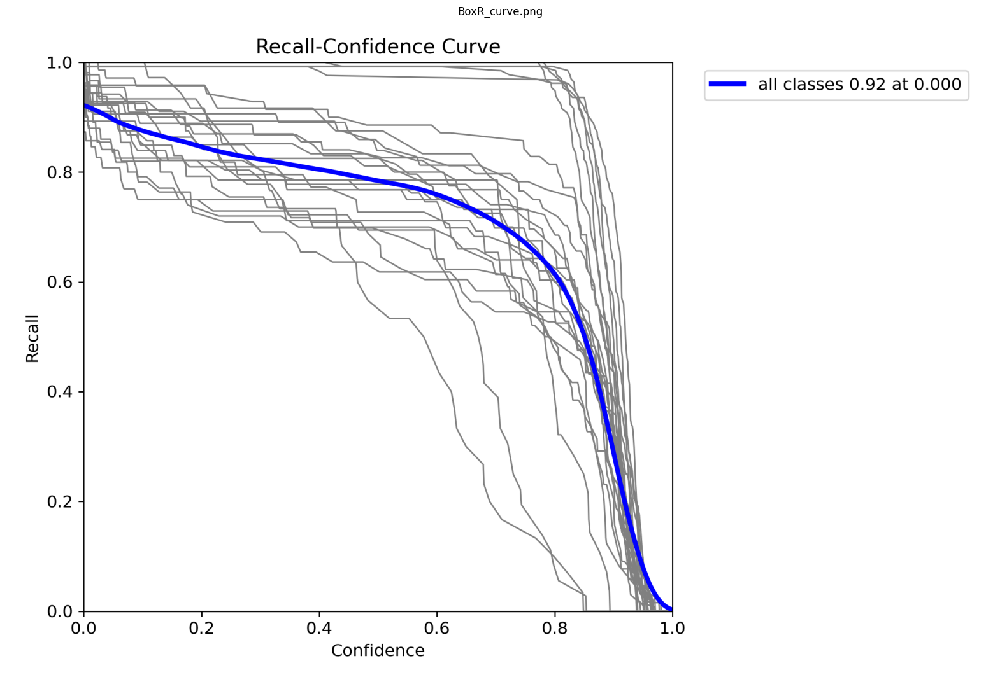

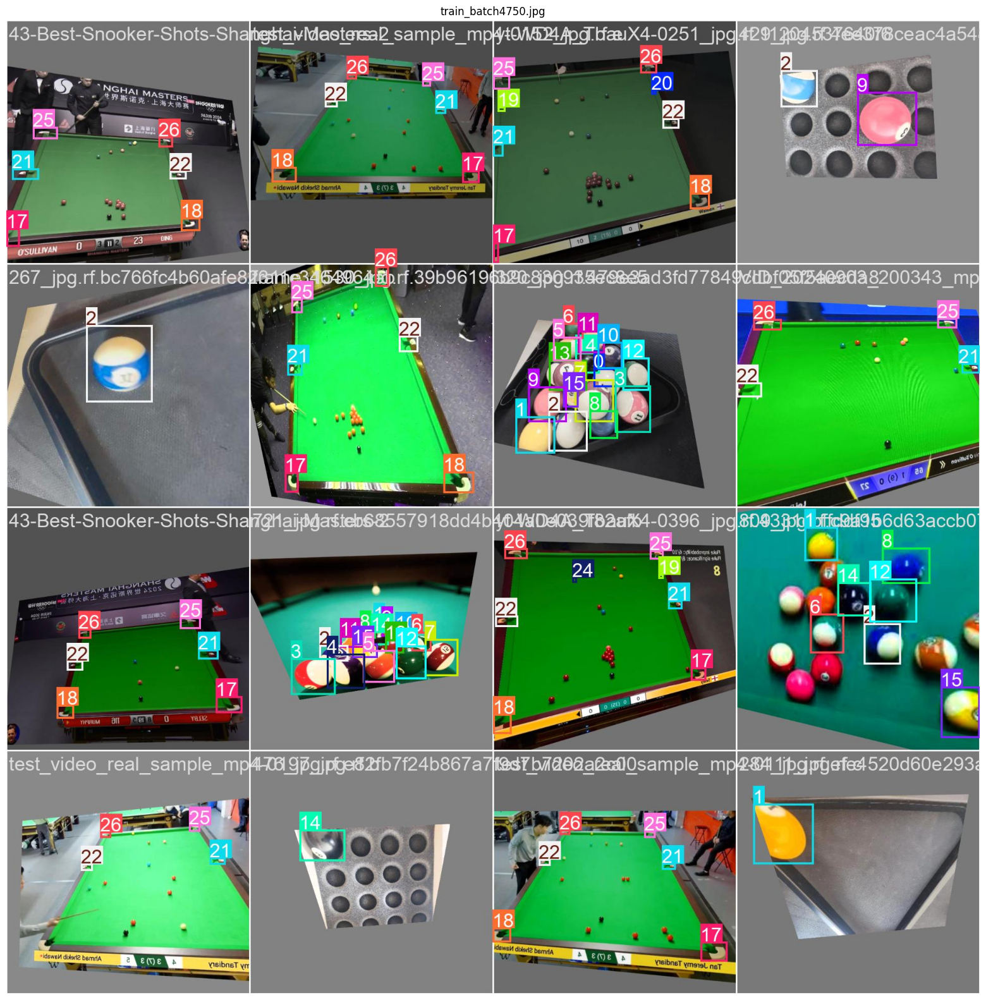

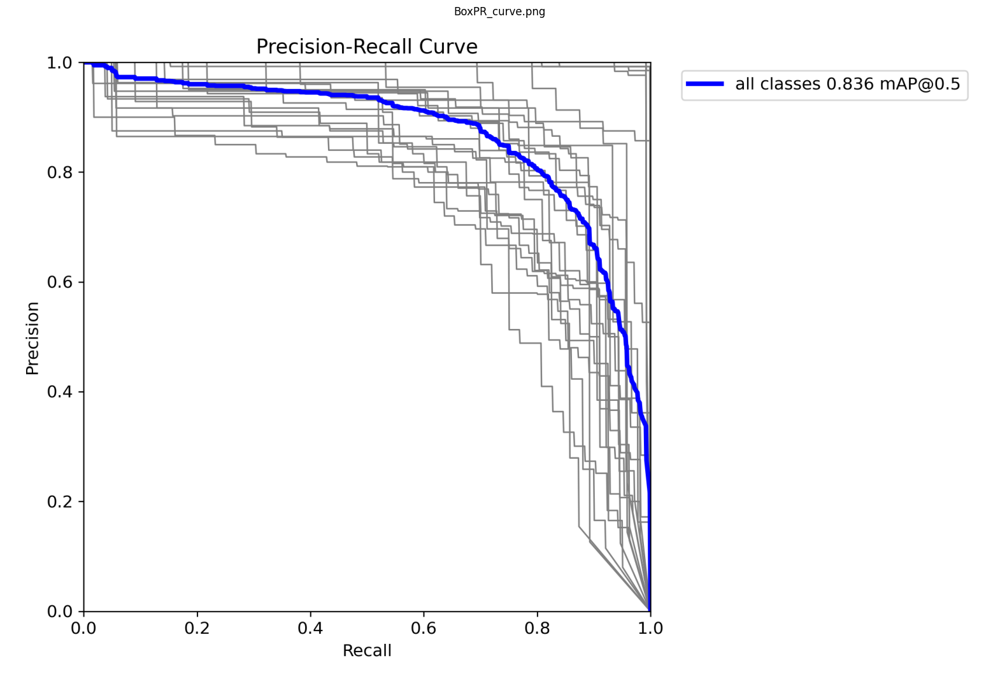

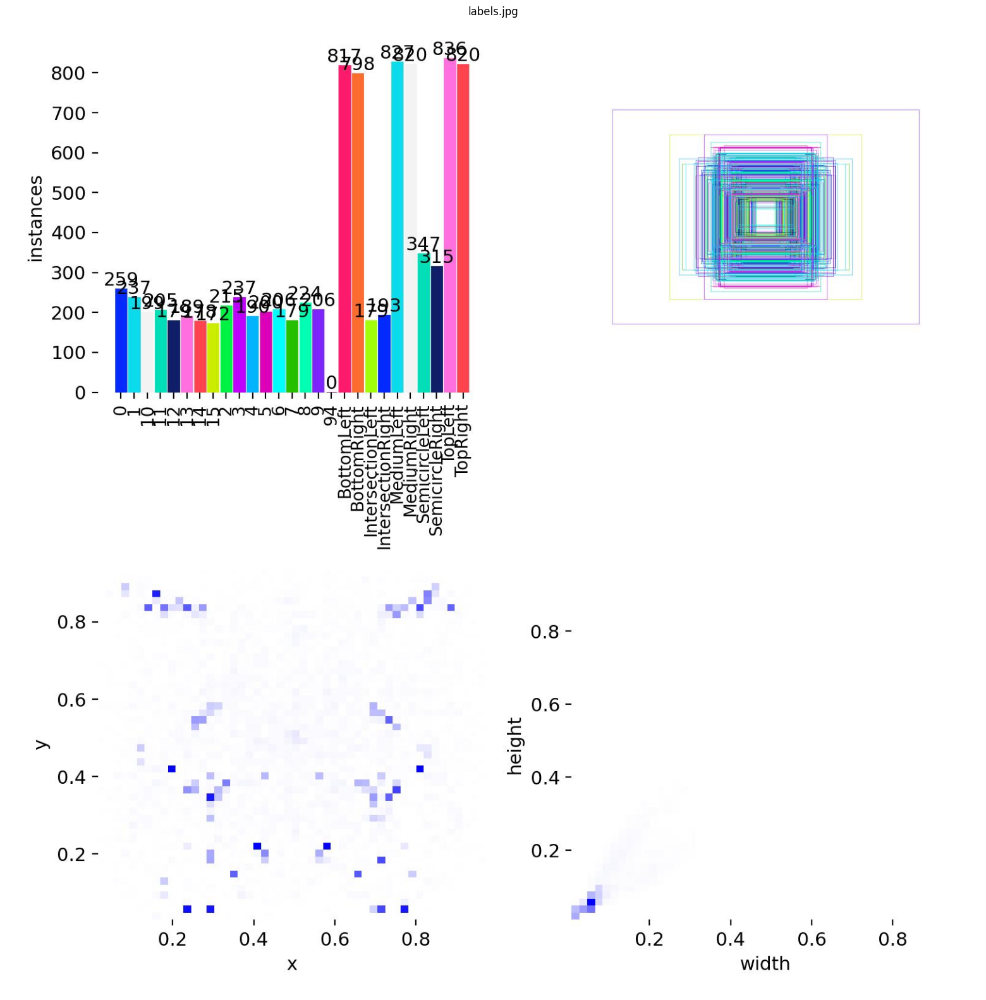

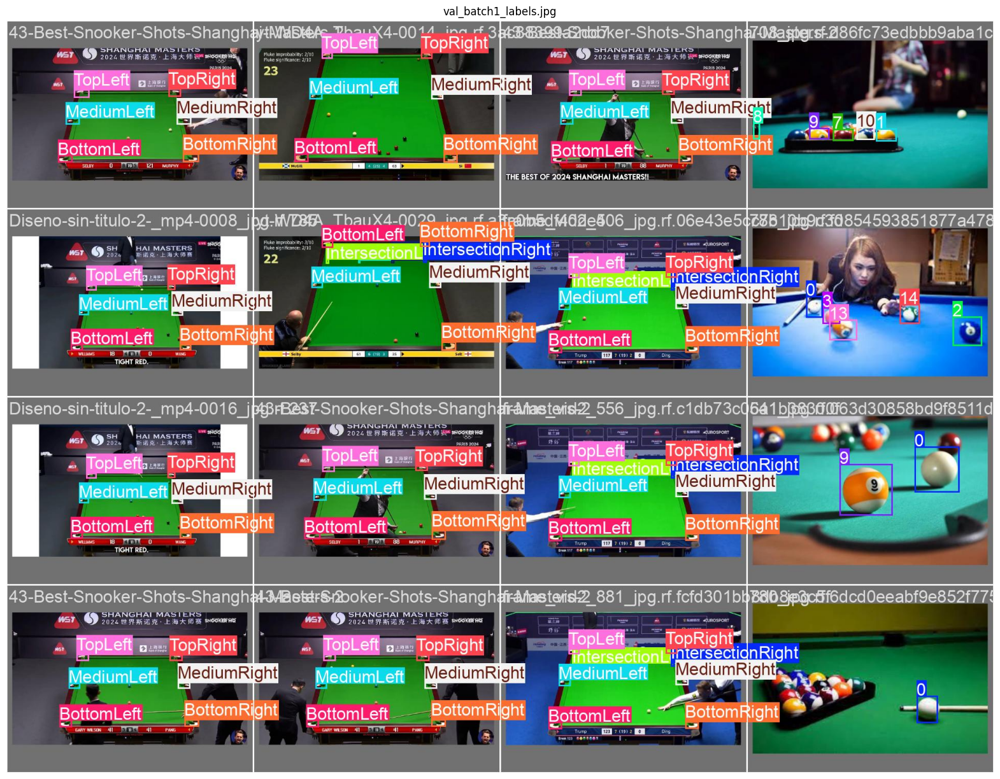

...

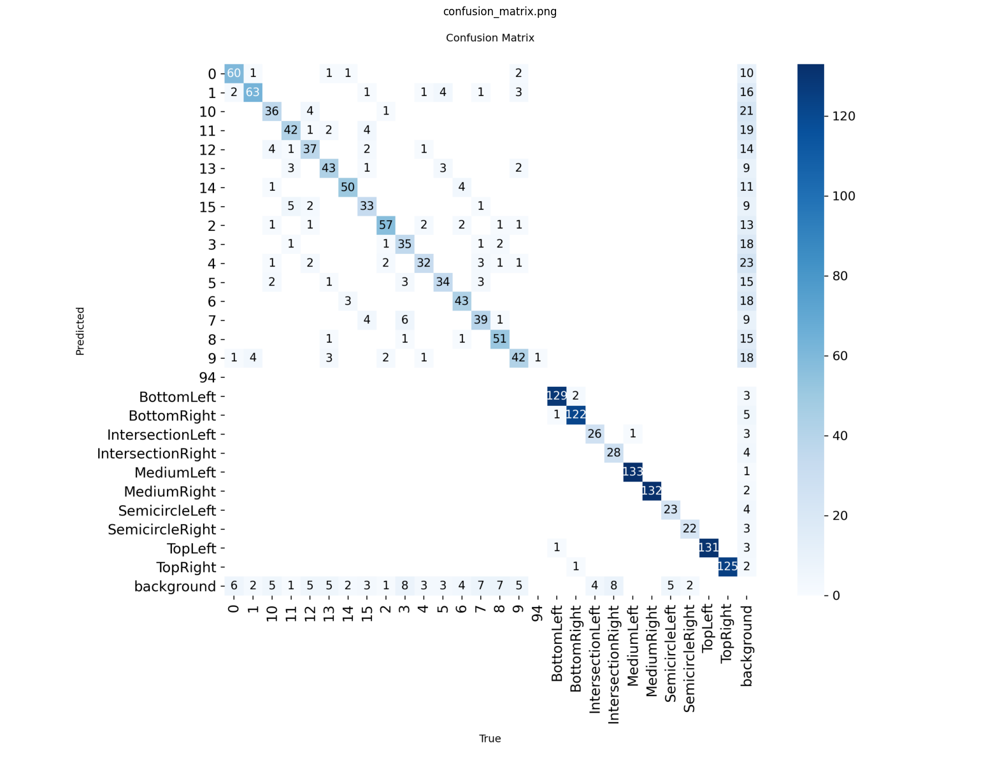

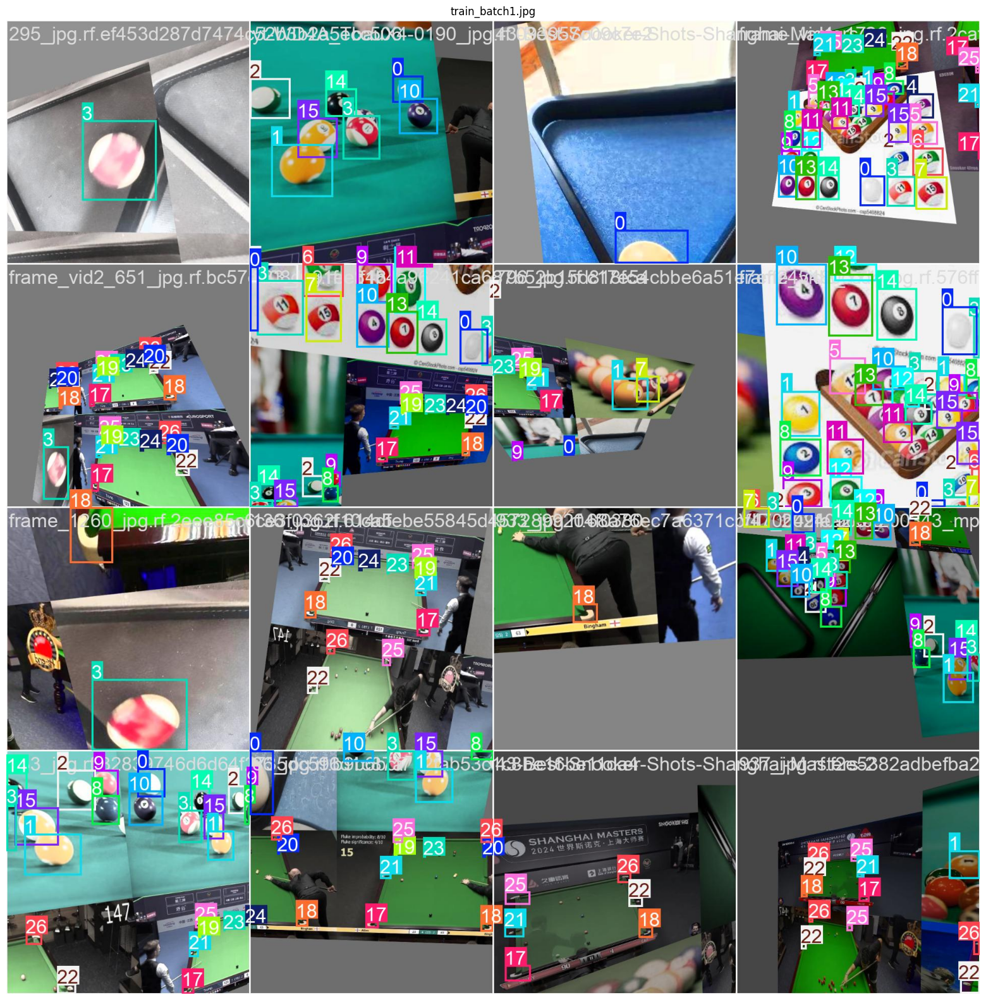

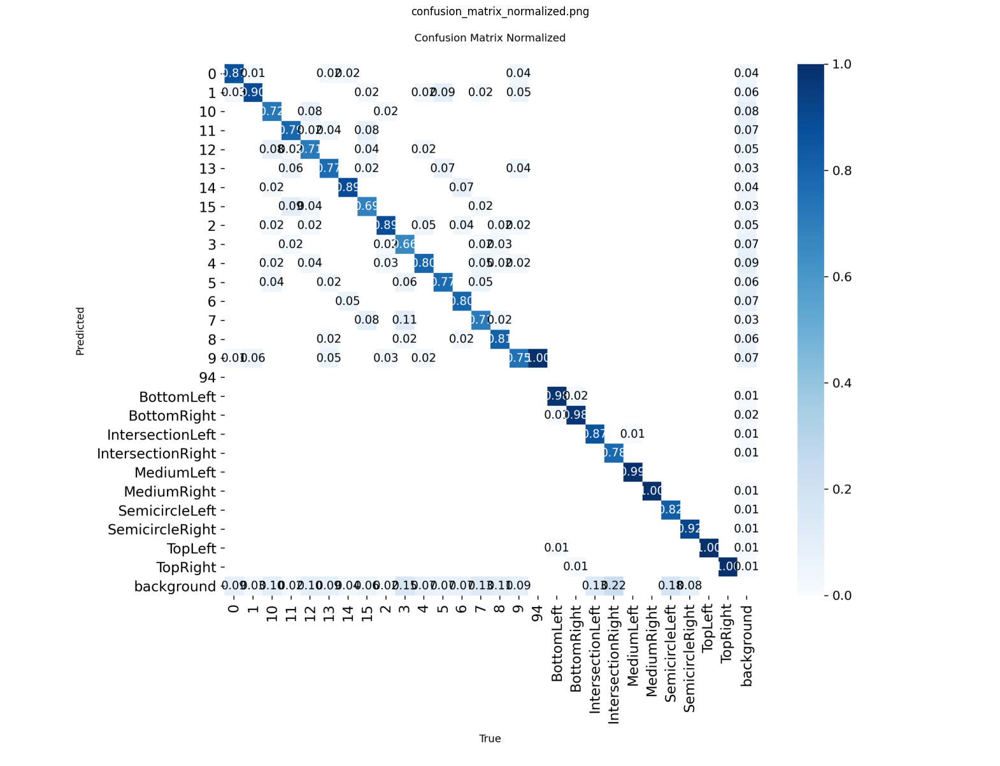

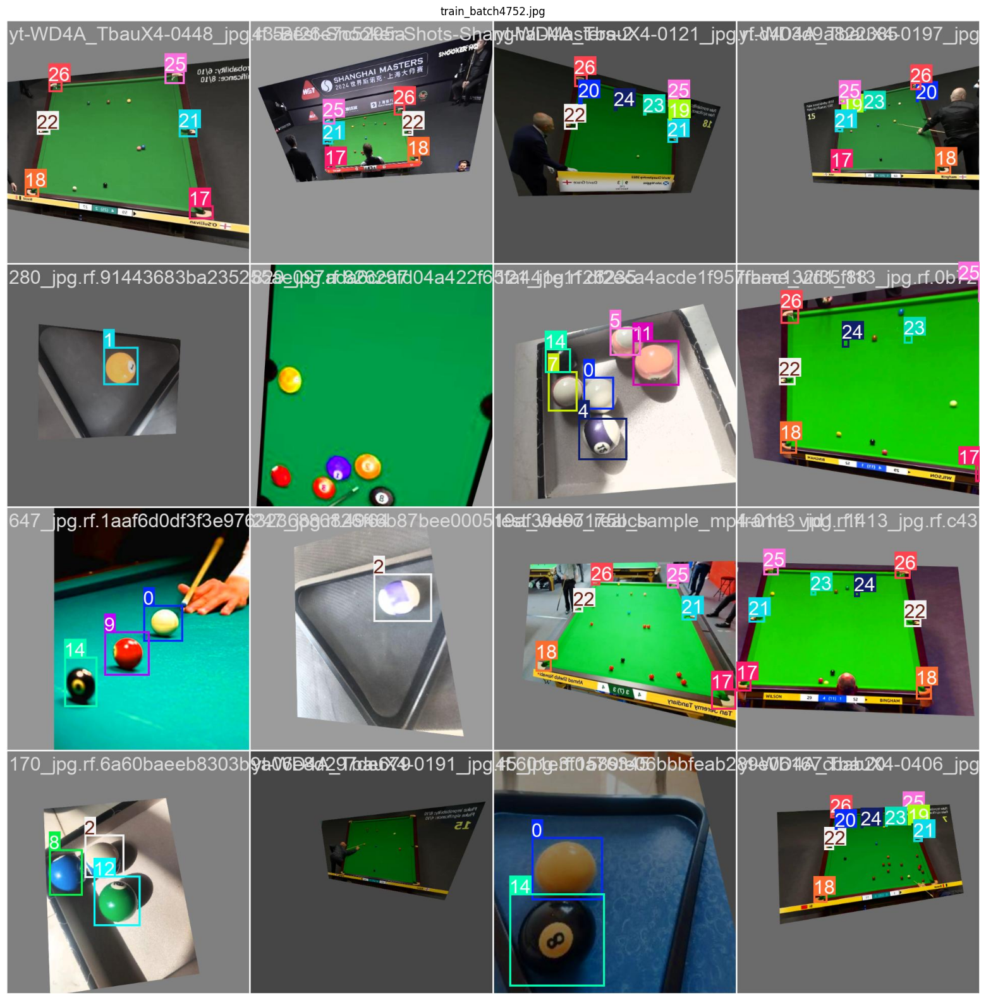

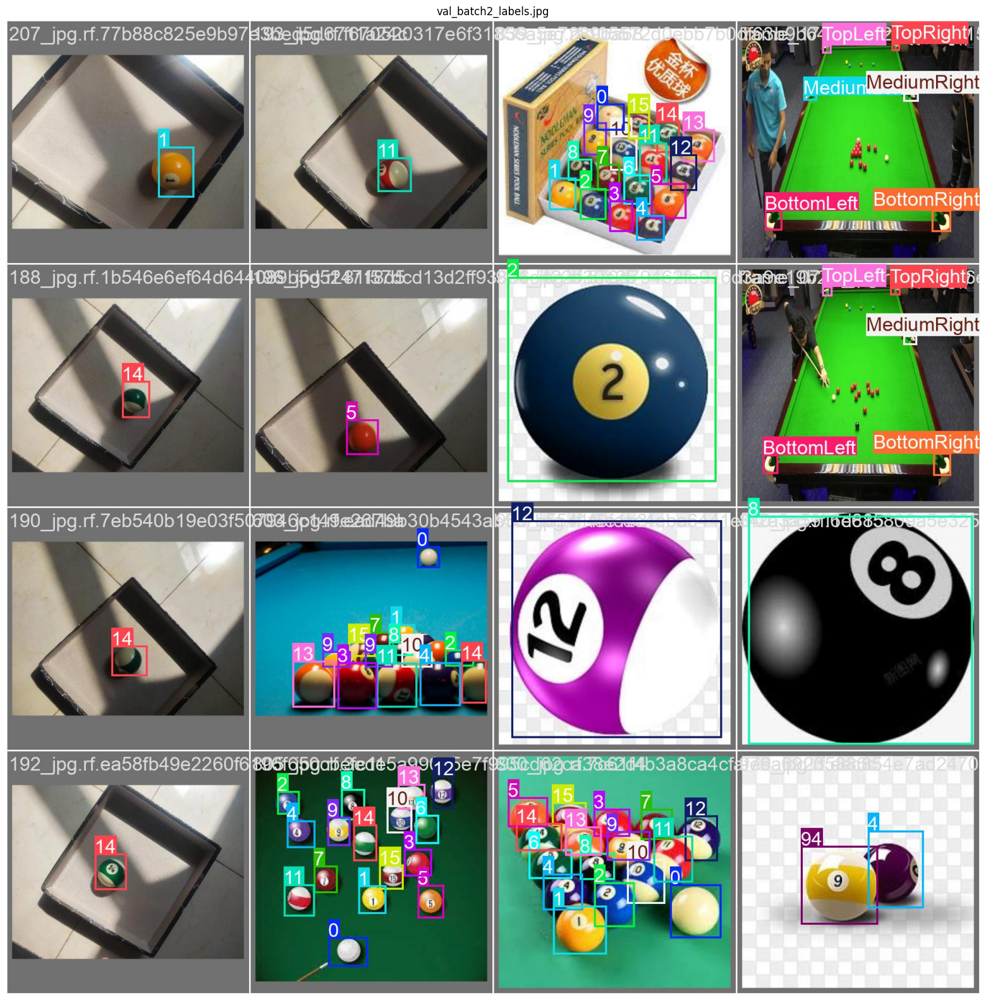

In [14]:
import os
import matplotlib.pyplot as plt
from PIL import Image

# Ruta donde están tus imágenes
path = "/kaggle/working/pdi_project_runs/entrenamiento_v2_optimizado/"

# Obtener lista de archivos de imagen
imagenes = [f for f in os.listdir(path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

print("Imágenes encontradas:", imagenes)

# Mostrar todas las imágenes una por una
for img_name in imagenes:
    img_path = os.path.join(path, img_name)

    img = Image.open(img_path)

    plt.figure(figsize=(20, 20))
    plt.imshow(img)
    plt.title(img_name)
    plt.axis('off')
    plt.show()
